In [271]:
import matplotlib
import torch
import torch.nn.functional as F
from torchdiffeq import odeint
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np
from IPython.display import clear_output
import torch.nn as nn
import torch.optim as optim
from tqdm.notebook import tqdm

In [272]:
class DoublePendulumODE(torch.nn.Module):
    def forward(self, t, z):
        """
        Defines the equations of motion for the double pendulum.

        Arguments:
        t: The independent variable (time).
        z: The state vector z = [theta1, theta2, p1, p2] where
            theta1, theta2: The angles of the pendulums.
            p1, p2: The angular momenta of the pendulums.

        Returns:
        dzdt: The time derivatives of the state vector z.
        """
        theta1, theta2, p1, p2 = z
        m1 = 0.5  # mass of pendulum 1
        m2 = 0.5  # mass of pendulum 2
        g = 9.8  # acceleration due to gravity
        l1 = 1.0  # length of pendulum 1
        l2 = 1.0  # length of pendulum 2

        # Convert angles to radians
        theta1_rad = torch.deg2rad(theta1)
        theta2_rad = torch.deg2rad(theta2)

        # Equations of motion
        theta1_dot = p1 / (m1 * l1 ** 2)
        theta2_dot = p2 / (m2 * l2 ** 2)

        p1_dot = (
            -m2 * l1 * l2 * theta2_dot ** 2 * torch.sin(theta1_rad - theta2_rad)
            - (m1 + m2) * g * torch.sin(theta1_rad) / l1
        )
        p2_dot = (
            m2 * l1 * l2 * theta1_dot ** 2 * torch.sin(theta1_rad - theta2_rad)
            - m2 * g * torch.sin(theta2_rad) / l2
        )

        dzdt = torch.tensor([theta1_dot, theta2_dot, p1_dot, p2_dot])
        return dzdt

In [125]:

a = torch.deg2rad(torch.tensor([-20., 35.]))
a

tensor([-0.3491,  0.6109])

In [126]:
a = torch.deg2rad(torch.tensor([140.,120.]))
a

tensor([2.4435, 2.0944])

In [273]:
data = torch.load('Data/pendulum_data.pt')

In [274]:
train = data[:6]
val = data[6]
test = data[7:]

In [275]:
# Initial conditions
z0 = torch.tensor([2.4435, 2.0944, 0., 0.])  # [theta1, theta2, p1, p2]
# Pendulum lengths
l1 = 1.0
l2 = 1.0
# Time points
t = torch.linspace(0, 100, 1000)

# Solve the ODE
true = odeint(DoublePendulumODE(), z0, t,method='rk4')

In [276]:
# Extract the angles
theta1 = true[:, 0]
theta2 = true[:, 1]

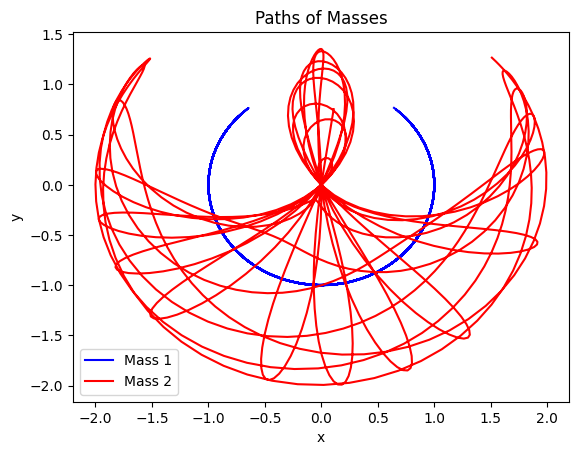

In [277]:
theta1_trajectory = []
theta2_trajectory = []
x1_trajectory = []
y1_trajectory = []
x2_trajectory = []
y2_trajectory = []

# Store the trajectories
for i in range(len(t)):
    theta1_trajectory.append(theta1[i].item())
    theta2_trajectory.append(theta2[i].item())

    # Compute the Cartesian coordinates of the pendulum
    x1 = l1 * torch.sin(theta1[i])
    y1 = -l1 * torch.cos(theta1[i])
    x2 = x1 + l2 * torch.sin(theta2[i])
    y2 = y1 - l2 * torch.cos(theta2[i])

    # Append coordinates to the trajectory lists
    x1_trajectory.append(x1.item())
    y1_trajectory.append(y1.item())
    x2_trajectory.append(x2.item())
    y2_trajectory.append(y2.item())

# Create a separate figure and axes for the paths of the masses
fig_paths, ax_paths = plt.subplots()

# Plot the paths of the masses
ax_paths.plot(x1_trajectory, y1_trajectory, 'b-', label='Mass 1')
ax_paths.plot(x2_trajectory, y2_trajectory, 'r-', label='Mass 2')
ax_paths.set_xlabel('x')
ax_paths.set_ylabel('y')
ax_paths.set_title('Paths of Masses')
ax_paths.legend()

# Display the paths plot
plt.show()

In [279]:
to_plot = true

In [280]:
# Define the number of previous positions to remember (trail length)
trail_length = 15  # You can adjust this value as needed

# Create lists to store previous positions
prev_positions1 = []
prev_positions2 = []

def animate(i):
    # Clear the plot
    ax.cla()

    # Get the angles for the current time step
    theta1 = to_plot[i, 0].item()
    theta2 = to_plot[i, 1].item()

    # Convert angles to tensors
    theta1 = torch.tensor(theta1)
    theta2 = torch.tensor(theta2)

    # Compute the Cartesian coordinates of the pendulum
    x1 = l1 * torch.sin(theta1)
    y1 = -l1 * torch.cos(theta1)
    x2 = x1 + l2 * torch.sin(theta2)
    y2 = y1 - l2 * torch.cos(theta2)

    # Store the current positions in the lists
    prev_positions1.append((x1, y1))
    prev_positions2.append((x2, y2))

    # Limit the length of the trail to the specified trail_length
    if len(prev_positions1) > trail_length:
        prev_positions1.pop(0)
        prev_positions2.pop(0)

    # Plot the trailing lines
    for j in range(len(prev_positions1) - 1):
        ax.plot([prev_positions1[j][0], prev_positions1[j + 1][0]],
                [prev_positions1[j][1], prev_positions1[j + 1][1]], 'b-', lw=1, alpha=0.7)  # Trailing line for Mass 1
        ax.plot([prev_positions2[j][0], prev_positions2[j + 1][0]],
                [prev_positions2[j][1], prev_positions2[j + 1][1]], 'r-', lw=1, alpha=0.7)  # Trailing line for Mass 2

    # Plot the pendulum
    ax.plot([0, x1], [0, y1], 'b-', lw=2)  # Rod 1
    ax.plot(x1, y1, 'bo', markersize=5)    # Mass 1
    ax.plot([x1, x2], [y1, y2], 'b-', lw=2)  # Rod 2
    ax.plot(x2, y2, 'ro', markersize=5)    # Mass 2
    
    
    # Set plot limits and aspect ratio
    ax.set_xlim(-l1 - l2 - 0.5, l1 + l2 + 0.5)
    ax.set_ylim(-l1 - l2 - 0.5, l1 + l2 + 0.5)
    ax.set_aspect('equal', adjustable='box')
    

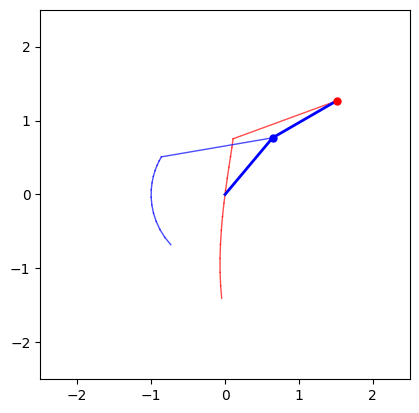

In [281]:
# Create a figure and axes
fig, ax = plt.subplots()
# Animate the pendulum
animation = FuncAnimation(fig, animate, frames=len(t), interval=50)

# Convert animation to HTML
html_animation = animation.to_jshtml()

# Display the animation
HTML(html_animation)

In [282]:
from sklearn.preprocessing import MinMaxScaler

In [283]:
window = 10
def create_sequences(input_data, w):
    seq = []
    labels = []
    L = len(input_data)
    for i in range(L-w):
        seq.append(input_data[i:i+w])
        labels.append(input_data[i+w:i+w+1])
       
    return seq, labels

def preprocess_sol(data, window):
    scaler = MinMaxScaler(feature_range=(-1, 1))
    train_data_normalized = scaler.fit_transform(data.reshape(-1, 4))
    train_data_normalized = torch.FloatTensor(train_data_normalized).view(-1)
    seqs,labels= create_sequences(train_data_normalized.reshape(data.size(0), 4), window)
    #print(len(seqs),len(labels))
    return torch.stack(seqs),torch.stack(labels)


In [284]:
class PendulumTrain(nn.Module):
    def __init__(self):
        super().__init__()
        self.lstm = nn.LSTM(4, hidden_layer_size)
        self.linear = nn.Linear(hidden_layer_size, 4)
        self.c_h = (torch.zeros(1,1,hidden_layer_size),
                    torch.zeros(1,1,hidden_layer_size))
    def forward(self, x):
        self.c_h = (torch.zeros(1, 1, hidden_layer_size),
                        torch.zeros(1, 1, hidden_layer_size))
        h, self.c_h= self.lstm(x.view(len(x) ,1, -1), self.c_h)
        predictions = self.linear(h.view(len(x), -1))
        return predictions[-1]

In [285]:
true.size(0)

1000

In [286]:
train = train.view(6000,4)

In [287]:
train.shape

torch.Size([6000, 4])

In [288]:
inputs,target = preprocess_sol(train, window)


In [289]:
inputs.shape,target.shape

(torch.Size([5990, 10, 4]), torch.Size([5990, 1, 4]))

In [290]:
model= PendulumTrain()

In [291]:
optimizer = optim.Adam(model.parameters(), lr=1e-2)

In [292]:
best_loss = 1000.
tolerance = 1e-7
loss_function = nn.MSELoss()
hidden_layer_size = 100
epochs =1000

for i in range(epochs):
    seq_err = 0.0
    for _ in range(900):
        num = np.random.randint(len(inputs))
        seq = inputs[num]
        labels = target[num]
        optimizer.zero_grad()
        y_pred = model(seq)

        loss = loss_function(y_pred.reshape(1,4), labels)
        if loss.item() < best_loss:
                best_loss = loss.item()
                torch.save(model.state_dict(), 'lstm-pend3')
        loss.backward()
        optimizer.step()
        seq_err+= loss.item()
    if i%100 == 0:
        print(f'epoch: {i:3} loss: {loss.item():10.10f}')
        print(f'seq: {i:3} loss: {seq_err:10.10f}')
    if seq_err < tolerance:
        break

print(f'epoch: {i:3} loss: {loss.item():10.10f}')



epoch:   0 loss: 0.0005448916
seq:   0 loss: 11.7776259908
epoch: 100 loss: 0.0000322838
seq: 100 loss: 0.6468655136
epoch: 200 loss: 0.0000062253
seq: 200 loss: 0.7772686623
epoch: 300 loss: 0.0001319533
seq: 300 loss: 1.1903496910
epoch: 400 loss: 0.0016542517
seq: 400 loss: 1.1208491843
epoch: 500 loss: 0.0000134932
seq: 500 loss: 0.1601520796
epoch: 600 loss: 0.0291210264
seq: 600 loss: 80.8425013822
epoch: 700 loss: 0.0006081511
seq: 700 loss: 1.1712501096
epoch: 800 loss: 0.0000453060
seq: 800 loss: 1.3213790344
epoch: 900 loss: 0.0003161382
seq: 900 loss: 1.1717641606
epoch: 999 loss: 0.0003255283


In [293]:
import os

In [294]:
test_model = PendulumTrain()

In [295]:
test_model.load_state_dict(torch.load('lstm-pend3'))

<All keys matched successfully>

In [296]:
def OneStep(data, steps = 100):
    print('data set length =', len(data))
    train_window = 10
    scaler = MinMaxScaler(feature_range=(-1, 1))
    train_data_normalized = scaler.fit_transform(data.reshape(-1, 4))
    fut_pred = len(data) -train_window
    test_inputs = train_data_normalized[0:train_window].reshape(train_window,4).tolist()
    model.eval()
    preds = test_inputs.copy()
    t2 = test_inputs
    hidden_layer_size = 100
    x = 0
    for i in range(fut_pred):
        seq = torch.FloatTensor(t2[i:])
        x = model(seq)
        preds.append(x.detach().numpy())
        t2.append(x.detach().numpy())
    actual_predictions = scaler.inverse_transform(np.array(preds ).reshape(-1,4))
    print(len(actual_predictions))
    return actual_predictions

In [297]:
pred =OneStep(test[0], steps=100)

data set length = 1000
1000


In [298]:
pred = torch.tensor(pred)

In [299]:
solution = pred

In [300]:
solution.shape

torch.Size([1000, 4])

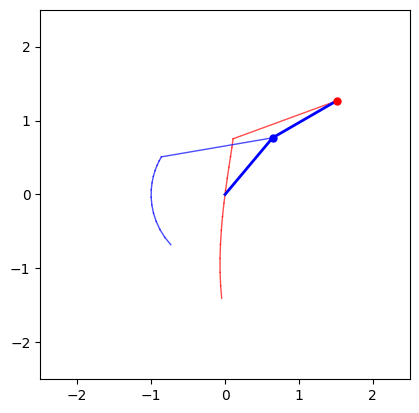

In [301]:
fig, ax = plt.subplots()
# Animate the pendulum
animation = FuncAnimation(fig, animate, frames=len(t), interval=50)

# Convert animation to HTML
html_animation = animation.to_jshtml()

# Display the animation
HTML(html_animation)

In [302]:
# Extract the angles
theta1 = pred[:, 0]
theta2 = pred[:, 1]

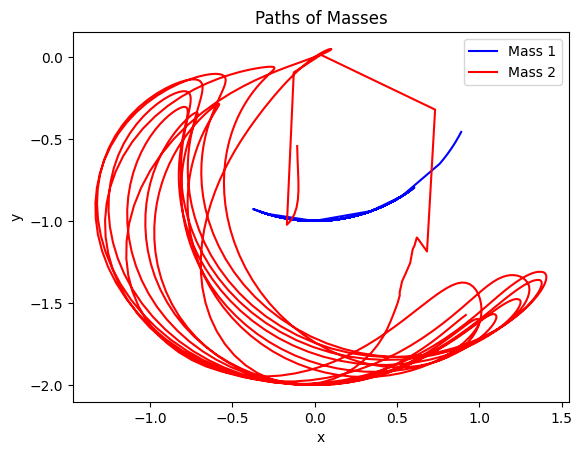

In [303]:
theta1_trajectory = []
theta2_trajectory = []
x1_trajectory = []
y1_trajectory = []
x2_trajectory = []
y2_trajectory = []

# Store the trajectories
for i in range(len(t)):
    theta1_trajectory.append(theta1[i].item())
    theta2_trajectory.append(theta2[i].item())

    # Compute the Cartesian coordinates of the pendulum
    x1 = l1 * torch.sin(theta1[i])
    y1 = -l1 * torch.cos(theta1[i])
    x2 = x1 + l2 * torch.sin(theta2[i])
    y2 = y1 - l2 * torch.cos(theta2[i])

    # Append coordinates to the trajectory lists
    x1_trajectory.append(x1.item())
    y1_trajectory.append(y1.item())
    x2_trajectory.append(x2.item())
    y2_trajectory.append(y2.item())

# Create a separate figure and axes for the paths of the masses
fig_paths, ax_paths = plt.subplots()

# Plot the paths of the masses
ax_paths.plot(x1_trajectory, y1_trajectory, 'b-', label='Mass 1')
ax_paths.plot(x2_trajectory, y2_trajectory, 'r-', label='Mass 2')
ax_paths.set_xlabel('x')
ax_paths.set_ylabel('y')
ax_paths.set_title('Paths of Masses')
ax_paths.legend()

# Display the paths plot
plt.show()

In [316]:
p1 = pred[:, 0].detach().numpy()
p2 = pred[:, 1].detach().numpy()

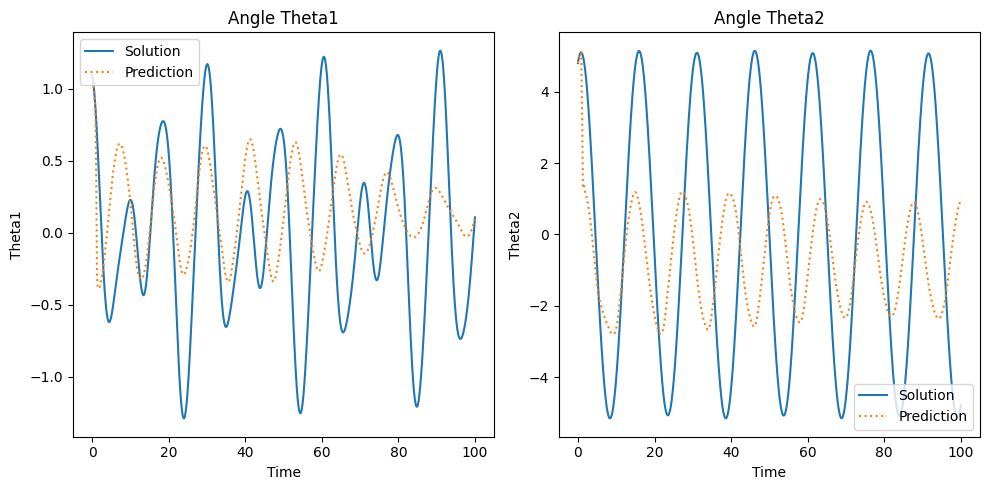

In [317]:
theta1 = test[0][:, 0].detach().numpy()
theta2 = test[0][:, 1].detach().numpy()

# Create separate plots for theta1 and theta2
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(t, theta1, label='Solution')
plt.plot(t, p1, linestyle='dotted', label='Prediction')
plt.xlabel('Time')
plt.ylabel('Theta1')
plt.title('Angle Theta1')
plt.legend()

# Plot for theta2
plt.subplot(1, 2, 2)
plt.plot(t, theta2, label='Solution')
plt.plot(t, p2, linestyle='dotted', label='Prediction')
plt.xlabel('Time')
plt.ylabel('Theta2')
plt.title('Angle Theta2')
plt.legend()

# Adjust subplot spacing
plt.tight_layout()

# Display the plots
plt.show()

In [166]:
test = PendulumTrain()

In [167]:
test.load_state_dict(torch.load('lstm-pend3'))

<All keys matched successfully>

In [168]:
z1 = torch.tensor([2.5, 2.1, 0., 0.])

In [169]:
test = odeint(DoublePendulumODE(), z1, t)

In [325]:
pred = OneStep(test[2], steps=100)

data set length = 1000
1000


In [326]:
pred = torch.tensor(pred)

In [327]:
# Extract the angles
theta1 = pred[:, 0]
theta2 = pred[:, 1]

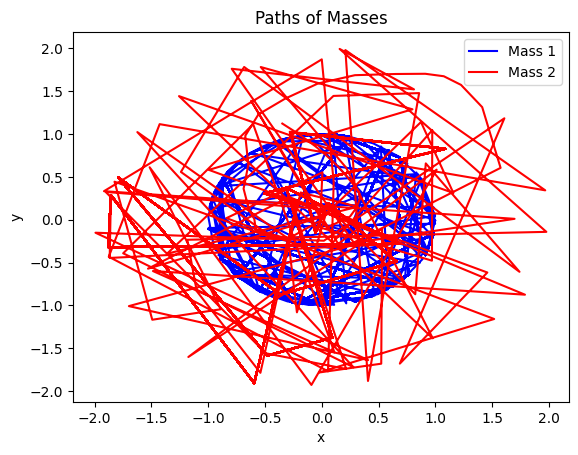

In [328]:
theta1_trajectory = []
theta2_trajectory = []
x1_trajectory = []
y1_trajectory = []
x2_trajectory = []
y2_trajectory = []

# Store the trajectories
for i in range(len(t)):
    theta1_trajectory.append(theta1[i].item())
    theta2_trajectory.append(theta2[i].item())

    # Compute the Cartesian coordinates of the pendulum
    x1 = l1 * torch.sin(theta1[i])
    y1 = -l1 * torch.cos(theta1[i])
    x2 = x1 + l2 * torch.sin(theta2[i])
    y2 = y1 - l2 * torch.cos(theta2[i])

    # Append coordinates to the trajectory lists
    x1_trajectory.append(x1.item())
    y1_trajectory.append(y1.item())
    x2_trajectory.append(x2.item())
    y2_trajectory.append(y2.item())

# Create a separate figure and axes for the paths of the masses
fig_paths, ax_paths = plt.subplots()

# Plot the paths of the masses
ax_paths.plot(x1_trajectory, y1_trajectory, 'b-', label='Mass 1')
ax_paths.plot(x2_trajectory, y2_trajectory, 'r-', label='Mass 2')
ax_paths.set_xlabel('x')
ax_paths.set_ylabel('y')
ax_paths.set_title('Paths of Masses')
ax_paths.legend()

# Display the paths plot
plt.show()

In [329]:
p1 = pred[:, 0].detach().numpy()
p2 = pred[:, 1].detach().numpy()

In [323]:
test.shape

torch.Size([3, 1000, 4])

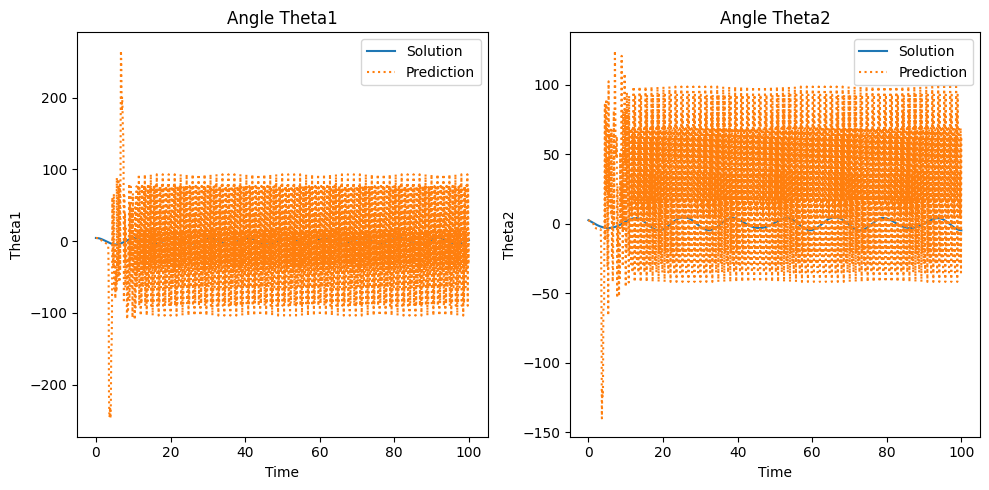

In [330]:
theta1 = test[2][:, 0].detach().numpy()
theta2 = test[2][:, 1].detach().numpy()

# Create separate plots for theta1 and theta2
plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.plot(t, theta1, label='Solution')
plt.plot(t, p1, linestyle='dotted', label='Prediction')
plt.xlabel('Time')
plt.ylabel('Theta1')
plt.title('Angle Theta1')
plt.legend()

# Plot for theta2
plt.subplot(1, 2, 2)
plt.plot(t, theta2, label='Solution')
plt.plot(t, p2, linestyle='dotted', label='Prediction')
plt.xlabel('Time')
plt.ylabel('Theta2')
plt.title('Angle Theta2')
plt.legend()

# Adjust subplot spacing
plt.tight_layout()

# Display the plots
plt.show()